In [1]:
import pandas as pd
import os
import matplotlib.pyplot as plt
import seaborn as sns
pd.set_option('display.max_columns', 500)

In [2]:
data = pd.read_csv("cancer_mama.csv",encoding="utf-8")
data.head(5)

,mean radius,mean texture,mean perimeter,mean area,mean smoothness,mean compactness,mean concavity,mean concave points,mean symmetry,mean fractal dimension,radius error,texture error,perimeter error,area error,smoothness error,compactness error,concavity error,concave points error,symmetry error,fractal dimension error,worst radius,worst texture,worst perimeter,worst area,worst smoothness,worst compactness,worst concavity,worst concave points,worst symmetry,worst fractal dimension,Cancer
0,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,0.2419,0.07871,1.0950,0.9053,8.589,153.40,0.006399,0.04904,0.05373,0.01587,0.03003,0.006193,25.38,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890,0
1,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,0.1812,0.05667,0.5435,0.7339,3.398,74.08,0.005225,0.01308,0.01860,0.01340,0.01389,0.003532,24.99,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902,0
2,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,0.2069,0.05999,0.7456,0.7869,4.585,94.03,0.006150,0.04006,0.03832,0.02058,0.02250,0.004571,23.57,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758,0
3,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,0.2597,0.09744,0.4956,1.1560,3.445,27.23,0.009110,0.07458,0.05661,0.01867,0.05963,0.009208,14.91,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300,0
4,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,0.1809,0.05883,0.7572,0.7813,5.438,94.44,0.011490,0.02461,0.05688,0.01885,0.01756,0.005115,22.54,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678,0


In [3]:
data.shape

(569, 31)

In [4]:
data.dtypes

mean radius                float64
mean texture               float64
mean perimeter             float64
mean area                  float64
mean smoothness            float64
mean compactness           float64
mean concavity             float64
mean concave points        float64
mean symmetry              float64
mean fractal dimension     float64
radius error               float64
texture error              float64
perimeter error            float64
area error                 float64
smoothness error           float64
compactness error          float64
concavity error            float64
concave points error       float64
symmetry error             float64
fractal dimension error    float64
worst radius               float64
worst texture              float64
worst perimeter            float64
worst area                 float64
worst smoothness           float64
worst compactness          float64
worst concavity            float64
worst concave points       float64
worst symmetry      

In [5]:
data["Cancer"].unique()

array([0, 1])

# Ingenieria de Variables y Tratamiento de los datos

Vemos que gran parte de las columnas son variables continuas, entonces veamos si hay que hacerle cambio a las variables y si hay datos nulos

In [6]:
data.isnull().any()

mean radius                False
mean texture               False
mean perimeter             False
mean area                  False
mean smoothness            False
mean compactness           False
mean concavity             False
mean concave points        False
mean symmetry              False
mean fractal dimension     False
radius error               False
texture error              False
perimeter error            False
area error                 False
smoothness error           False
compactness error          False
concavity error            False
concave points error       False
symmetry error             False
fractal dimension error    False
worst radius               False
worst texture              False
worst perimeter            False
worst area                 False
worst smoothness           False
worst compactness          False
worst concavity            False
worst concave points       False
worst symmetry             False
worst fractal dimension    False
Cancer    

In [7]:
def missing_zero_values_table(df):

        zero_val = (df == 0.00).astype(int).sum(axis=0)

        mis_val = df.isnull().sum()

        mis_val_percent = 100 * df.isnull().sum() / len(df)

        mz_table = pd.concat([zero_val, mis_val, mis_val_percent], axis=1)

        mz_table = mz_table.rename(

        columns = {0 : 'Zero Values', 1 : 'Missing Values', 2 : '% of Total Values'})

        mz_table['Total Zero Missing Values'] = mz_table['Zero Values'] + mz_table['Missing Values']

        mz_table['% Total Zero Missing Values'] = 100 * mz_table['Total Zero Missing Values'] / len(df)

        mz_table['Data Type'] = df.dtypes

        mz_table = mz_table[

            mz_table.iloc[:,1] != 0].sort_values(

        '% of Total Values', ascending=False).round(1)

        print ("Your selected dataframe has " + str(df.shape[1]) + " columns and " + str(df.shape[0]) + " Rows.\n"      

            "There are " + str(mz_table.shape[0]) +

              " columns that have missing values.")

        return mz_table
    
missing_zero_values_table(data)

Your selected dataframe has 31 columns and 569 Rows.
There are 0 columns that have missing values.


,Zero Values,Missing Values,% of Total Values,Total Zero Missing Values,% Total Zero Missing Values,Data Type


<AxesSubplot:>

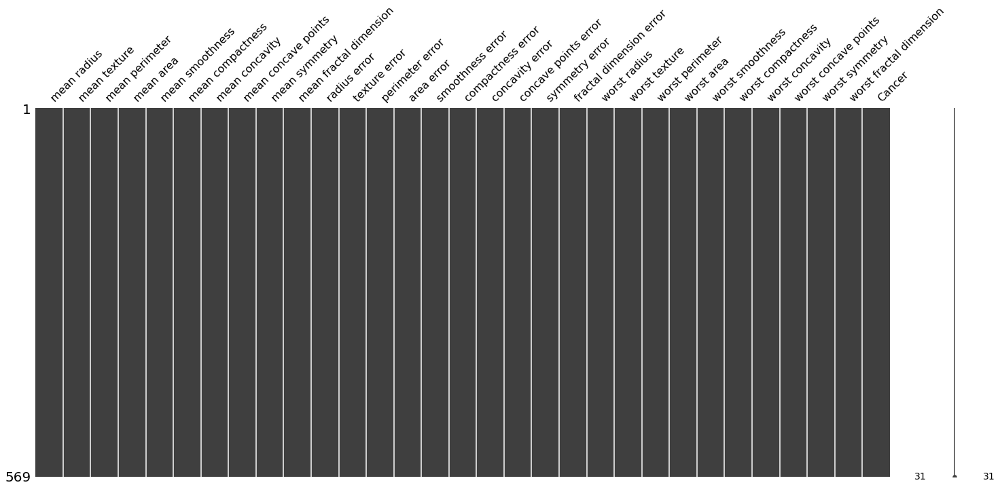

In [8]:
import missingno as msno
msno.matrix(data)

In [9]:
#Veamos si hay datos duplicados
data.duplicated().sum()

0

Podemos observar por su composición no hay datos nulos, por lo cuál no hay que realizarle ningun tipo de cambio al data set original.

# Análisis Exploratoria de Datos y Datos Atipicos

Se puede observar que todas las variables son continuas menos la variable Cancer que será nuestra traget ya que es la que nos dará la pauta para solucionar el problema

In [10]:
data.columns

Index(['mean radius', 'mean texture', 'mean perimeter', 'mean area',
       'mean smoothness', 'mean compactness', 'mean concavity',
       'mean concave points', 'mean symmetry', 'mean fractal dimension',
       'radius error', 'texture error', 'perimeter error', 'area error',
       'smoothness error', 'compactness error', 'concavity error',
       'concave points error', 'symmetry error', 'fractal dimension error',
       'worst radius', 'worst texture', 'worst perimeter', 'worst area',
       'worst smoothness', 'worst compactness', 'worst concavity',
       'worst concave points', 'worst symmetry', 'worst fractal dimension',
       'Cancer'],
      dtype='object')

In [11]:
vdisc=["Cancer"]

In [12]:
data["Cancer"].value_counts(1,dropna=False)

1    0.627417
0    0.372583
Name: Cancer, dtype: float64

In [13]:
vcont=[c for c in data.columns if c not in vdisc]
vcont

['mean radius',
 'mean texture',
 'mean perimeter',
 'mean area',
 'mean smoothness',
 'mean compactness',
 'mean concavity',
 'mean concave points',
 'mean symmetry',
 'mean fractal dimension',
 'radius error',
 'texture error',
 'perimeter error',
 'area error',
 'smoothness error',
 'compactness error',
 'concavity error',
 'concave points error',
 'symmetry error',
 'fractal dimension error',
 'worst radius',
 'worst texture',
 'worst perimeter',
 'worst area',
 'worst smoothness',
 'worst compactness',
 'worst concavity',
 'worst concave points',
 'worst symmetry',
 'worst fractal dimension']

In [14]:
data[vcont].describe(percentiles=[0.1,0.25,0.5,0.75,0.9])

,mean radius,mean texture,mean perimeter,mean area,mean smoothness,mean compactness,mean concavity,mean concave points,mean symmetry,mean fractal dimension,radius error,texture error,perimeter error,area error,smoothness error,compactness error,concavity error,concave points error,symmetry error,fractal dimension error,worst radius,worst texture,worst perimeter,worst area,worst smoothness,worst compactness,worst concavity,worst concave points,worst symmetry,worst fractal dimension
count,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000
mean,14.127292,19.289649,91.969033,654.889104,0.096360,0.104341,0.088799,0.048919,0.181162,0.062798,0.405172,1.216853,2.866059,40.337079,0.007041,0.025478,0.031894,0.011796,0.020542,0.003795,16.269190,25.677223,107.261213,880.583128,0.132369,0.254265,0.272188,0.114606,0.290076,0.083946
std,3.524049,4.301036,24.298981,351.914129,0.014064,0.052813,0.079720,0.038803,0.027414,0.007060,0.277313,0.551648,2.021855,45.491006,0.003003,0.017908,0.030186,0.006170,0.008266,0.002646,4.833242,6.146258,33.602542,569.356993,0.022832,0.157336,0.208624,0.065732,0.061867,0.018061
min,6.981000,9.710000,43.790000,143.500000,0.052630,0.019380,0.000000,0.000000,0.106000,0.049960,0.111500,0.360200,0.757000,6.802000,0.001713,0.002252,0.000000,0.000000,0.007882,0.000895,7.930000,12.020000,50.410000,185.200000,0.071170,0.027290,0.000000,0.000000,0.156500,0.055040
10%,10.260000,14.078000,65.830000,321.600000,0.079654,0.049700,0.013686,0.011158,0.149580,0.055338,0.183080,0.640400,1.280200,13.160000,0.004224,0.009169,0.007726,0.005493,0.013012,0.001710,11.234000,17.800000,72.178000,384.720000,0.102960,0.093676,0.045652,0.038460,0.226120,0.065792
25%,11.700000,16.170000,75.170000,420.300000,0.086370,0.064920,0.029560,0.020310,0.161900,0.057700,0.232400,0.833900,1.606000,17.850000,0.005169,0.013080,0.015090,0.007638,0.015160,0.002248,13.010000,21.080000,84.110000,515.300000,0.116600,0.147200,0.114500,0.064930,0.250400,0.071460
50%,13.370000,18.840000,86.240000,551.100000,0.095870,0.092630,0.061540,0.033500,0.179200,0.061540,0.324200,1.108000,2.287000,24.530000,0.006380,0.020450,0.025890,0.010930,0.018730,0.003187,14.970000,25.410000,97.660000,686.500000,0.131300,0.211900,0.226700,0.099930,0.282200,0.080040
75%,15.780000,21.800000,104.100000,782.700000,0.105300,0.130400,0.130700,0.074000,0.195700,0.066120,0.478900,1.474000,3.357000,45.190000,0.008146,0.032450,0.042050,0.014710,0.023480,0.004558,18.790000,29.720000,125.400000,1084.000000,0.146000,0.339100,0.382900,0.161400,0.317900,0.092080
90%,19.530000,24.992000,129.100000,1177.400000,0.114820,0.175460,0.203040,0.100420,0.214940,0.072266,0.748880,1.909400,5.123200,91.314000,0.010410,0.047602,0.058520,0.018688,0.030120,0.006185,23.682000,33.646000,157.740000,1673.000000,0.161480,0.447840,0.571320,0.208940,0.360080,0.106320
max,28.110000,39.280000,188.500000,2501.000000,0.163400,0.345400,0.426800,0.201200,0.304000,0.097440,2.873000,4.885000,21.980000,542.200000,0.031130,0.135400,0.396000,0.052790,0.078950,0.029840,36.040000,49.540000,251.200000,4254.000000,0.222600,1.058000,1.252000,0.291000,0.663800,0.207500


Podemos apreciar que en unas cuantas variables hay presencia de outliers considerables, en especias en worst_x

In [15]:
import plotly.express as px
def box_plot(data,column):
    fig = px.box(data, y=column,notched=True,title="Boxplot "+column)
    fig.show()

In [16]:
for c in vcont:
    box_plot(data,c)

Podemos observar que varias columnas cuentan con datos atipicos, por lo cual vamos a eliminarlos.

In [17]:
#Usaremos el iqr
def iqr_(df, variables, alpha = 3):

    
    for v in variables:
        q3 = df[v].quantile(.75)
        q1 = df[v].quantile(.25)        
        iqr = q3 - q1
        lb, up = q1-(alpha*iqr), q3+(alpha*iqr)
        df = df.loc[(df[v]>=lb) & (df[v]<=up)].copy()
        
    return(df)

In [18]:
print(data.shape)
print(iqr_(data,vcont,1.5).shape)
1-(iqr_(data,vcont,1.5).shape[0]/data.shape[0])

(569, 31)
(277, 31)


0.5131810193321618

Se elimino casi el 51% de los datos, por lo cual vamos a usar un metodo multivariante llamado isolation forest

In [19]:
# Se utilizará isolation Forest
from sklearn.ensemble import IsolationForest

# Seleccionamos el conjunto de datos
df_iso=data[vcont]

# Entrenamos el modelo
max_features=df_iso.shape[1]
n_estimators=50
max_samples='auto'
contamination=float(0.2)
model=IsolationForest(max_features = max_features, n_estimators=n_estimators, max_samples=max_samples, contamination=contamination)
model.fit(df_iso)

# Predecimos si es Outlier o no
df_iso["outlier"]=model.predict(df_iso)
# Vemos la proporción
df_iso["outlier"].value_counts()

/Users/jesusarredondo/Documents/Diplomado/Modulo2/mod2/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning:

X does not have valid feature names, but IsolationForest was fitted with feature names



 1    455
-1    114
Name: outlier, dtype: int64

In [20]:
#Veamos que porcentaje ocupan los -1 del tamaño total
len(df_iso.loc[df_iso["outlier"]==-1])/len(data)

0.20035149384885764

Gracias al anterior modelo perdemos solamente el 20% de nuestros datos

In [21]:
indice_outliers = list(df_iso.loc[df_iso["outlier"]==-1].index)

In [22]:
data.drop(indice_outliers,axis=0,inplace=True,errors="ignore")
data.shape[0]

455

In [23]:
455/569

0.7996485061511424

In [24]:
data=data.reset_index(drop=True)
data

,mean radius,mean texture,mean perimeter,mean area,mean smoothness,mean compactness,mean concavity,mean concave points,mean symmetry,mean fractal dimension,radius error,texture error,perimeter error,area error,smoothness error,compactness error,concavity error,concave points error,symmetry error,fractal dimension error,worst radius,worst texture,worst perimeter,worst area,worst smoothness,worst compactness,worst concavity,worst concave points,worst symmetry,worst fractal dimension,Cancer
0,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.086900,0.07017,0.1812,0.05667,0.5435,0.7339,3.398,74.08,0.005225,0.01308,0.018600,0.013400,0.01389,0.003532,24.99,23.41,158.80,1956.0,0.1238,0.1866,0.24160,0.18600,0.2750,0.08902,0
1,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.197400,0.12790,0.2069,0.05999,0.7456,0.7869,4.585,94.03,0.006150,0.04006,0.038320,0.020580,0.02250,0.004571,23.57,25.53,152.50,1709.0,0.1444,0.4245,0.45040,0.24300,0.3613,0.08758,0
2,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.198000,0.10430,0.1809,0.05883,0.7572,0.7813,5.438,94.44,0.011490,0.02461,0.056880,0.018850,0.01756,0.005115,22.54,16.67,152.20,1575.0,0.1374,0.2050,0.40000,0.16250,0.2364,0.07678,0
3,12.45,15.70,82.57,477.1,0.12780,0.17000,0.157800,0.08089,0.2087,0.07613,0.3345,0.8902,2.217,27.19,0.007510,0.03345,0.036720,0.011370,0.02165,0.005082,15.47,23.75,103.40,741.6,0.1791,0.5249,0.53550,0.17410,0.3985,0.12440,0
4,18.25,19.98,119.60,1040.0,0.09463,0.10900,0.112700,0.07400,0.1794,0.05742,0.4467,0.7732,3.180,53.91,0.004314,0.01382,0.022540,0.010390,0.01369,0.002179,22.88,27.66,153.20,1606.0,0.1442,0.2576,0.37840,0.19320,0.3063,0.08368,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
450,10.16,19.59,64.73,311.7,0.10030,0.07504,0.005025,0.01116,0.1791,0.06331,0.2441,2.0900,1.648,16.80,0.012910,0.02222,0.004174,0.007082,0.02572,0.002278,10.65,22.88,67.88,347.3,0.1265,0.1200,0.01005,0.02232,0.2262,0.06742,1
451,14.59,22.68,96.39,657.1,0.08473,0.13300,0.102900,0.03736,0.1454,0.06147,0.2254,1.1080,2.224,19.54,0.004242,0.04639,0.065780,0.016060,0.01638,0.004406,15.48,27.27,105.90,733.5,0.1026,0.3171,0.36620,0.11050,0.2258,0.08004,1
452,11.51,23.93,74.52,403.5,0.09261,0.10210,0.111200,0.04105,0.1388,0.06570,0.2388,2.9040,1.936,16.97,0.008200,0.02982,0.057380,0.012670,0.01488,0.004738,12.48,37.16,82.28,474.2,0.1298,0.2517,0.36300,0.09653,0.2112,0.08732,1
453,14.05,27.15,91.38,600.4,0.09929,0.11260,0.044620,0.04304,0.1537,0.06171,0.3645,1.4920,2.888,29.84,0.007256,0.02678,0.020710,0.016260,0.02080,0.005304,15.30,33.17,100.20,706.7,0.1241,0.2264,0.13260,0.10480,0.2250,0.08321,1


In [25]:
data[vcont].describe(percentiles=[0.1,0.25,0.5,0.75,0.9])

,mean radius,mean texture,mean perimeter,mean area,mean smoothness,mean compactness,mean concavity,mean concave points,mean symmetry,mean fractal dimension,radius error,texture error,perimeter error,area error,smoothness error,compactness error,concavity error,concave points error,symmetry error,fractal dimension error,worst radius,worst texture,worst perimeter,worst area,worst smoothness,worst compactness,worst concavity,worst concave points,worst symmetry,worst fractal dimension
count,455.000000,455.000000,455.000000,455.000000,455.000000,455.000000,455.000000,455.000000,455.000000,455.000000,455.000000,455.000000,455.000000,455.000000,455.000000,455.000000,455.000000,455.000000,455.000000,455.000000,455.000000,455.000000,455.000000,455.000000,455.000000,455.000000,455.000000,455.000000,455.000000,455.000000
mean,13.723587,18.823253,88.818857,604.504615,0.094518,0.090562,0.067633,0.040351,0.176345,0.061311,0.338067,1.153535,2.354065,30.567497,0.006674,0.020738,0.025287,0.010524,0.019203,0.003155,15.584820,25.152352,101.931473,784.170769,0.130176,0.220108,0.225987,0.102559,0.282841,0.080154
std,2.757886,4.043933,18.736472,256.239975,0.012202,0.036701,0.053816,0.028767,0.022006,0.005083,0.159987,0.476271,1.087226,21.004104,0.002424,0.010870,0.015324,0.004383,0.006058,0.001402,3.675364,5.763557,24.934065,390.889357,0.020321,0.113809,0.154112,0.053833,0.050167,0.013006
min,8.196000,9.710000,51.710000,201.900000,0.064290,0.026500,0.000000,0.000000,0.116700,0.049960,0.114400,0.360200,0.757000,6.802000,0.002667,0.003012,0.000000,0.000000,0.009539,0.000895,8.964000,12.020000,57.260000,242.200000,0.084090,0.043270,0.000000,0.000000,0.171200,0.055210
10%,10.680000,13.980000,68.562000,348.040000,0.079588,0.047578,0.014308,0.011266,0.148700,0.055380,0.180860,0.622540,1.234800,13.004000,0.004123,0.008990,0.007952,0.005495,0.012926,0.001665,11.668000,17.700000,75.394000,411.580000,0.103480,0.094112,0.048682,0.039858,0.226400,0.065600
25%,11.725000,15.950000,75.265000,421.950000,0.085110,0.061385,0.026880,0.019225,0.160100,0.057425,0.223900,0.808250,1.534500,17.385000,0.005014,0.012460,0.014085,0.007318,0.014840,0.002099,13.060000,20.870000,84.385000,517.950000,0.114550,0.138450,0.105250,0.062960,0.248100,0.070580
50%,13.170000,18.490000,85.090000,537.300000,0.094270,0.083480,0.048940,0.029950,0.176700,0.060880,0.295400,1.059000,2.105000,22.790000,0.006113,0.018050,0.021850,0.010040,0.018170,0.002817,14.670000,25.050000,95.480000,656.700000,0.129800,0.196500,0.190100,0.090770,0.277200,0.078090
75%,15.045000,21.255000,97.920000,691.950000,0.102850,0.114400,0.098610,0.057780,0.192350,0.064515,0.412900,1.399000,2.852500,35.490000,0.007856,0.027700,0.034220,0.013110,0.021915,0.003941,17.290000,28.900000,114.150000,908.300000,0.142850,0.281250,0.328650,0.142050,0.310400,0.087095
90%,18.220000,23.962000,118.660000,1030.600000,0.110060,0.143720,0.149060,0.087228,0.203560,0.068406,0.575100,1.807400,3.969800,62.438000,0.009944,0.037080,0.047876,0.016366,0.027442,0.004910,21.388000,33.026000,141.680000,1409.200000,0.154920,0.383860,0.437580,0.182700,0.342820,0.097592
max,21.370000,39.280000,141.300000,1386.000000,0.129100,0.202200,0.254500,0.132200,0.254000,0.079760,0.955300,2.904000,6.487000,124.400000,0.017360,0.059810,0.080790,0.034410,0.050140,0.009423,26.140000,44.870000,170.300000,2145.000000,0.190900,0.664300,0.735600,0.270100,0.488200,0.127500


In [26]:
for c in vcont:
    box_plot(data,c)

In [27]:
import plotly.figure_factory as ff

def distplot(data,column):

    hist_data = [data[column]]
    group_labels = ['distplot'] # name of the dataset

    fig = ff.create_distplot(hist_data, group_labels)
    fig.update_layout(title_text='Displot '+ column)
    fig.show()

In [28]:
for c in vcont:
    distplot(data,c)

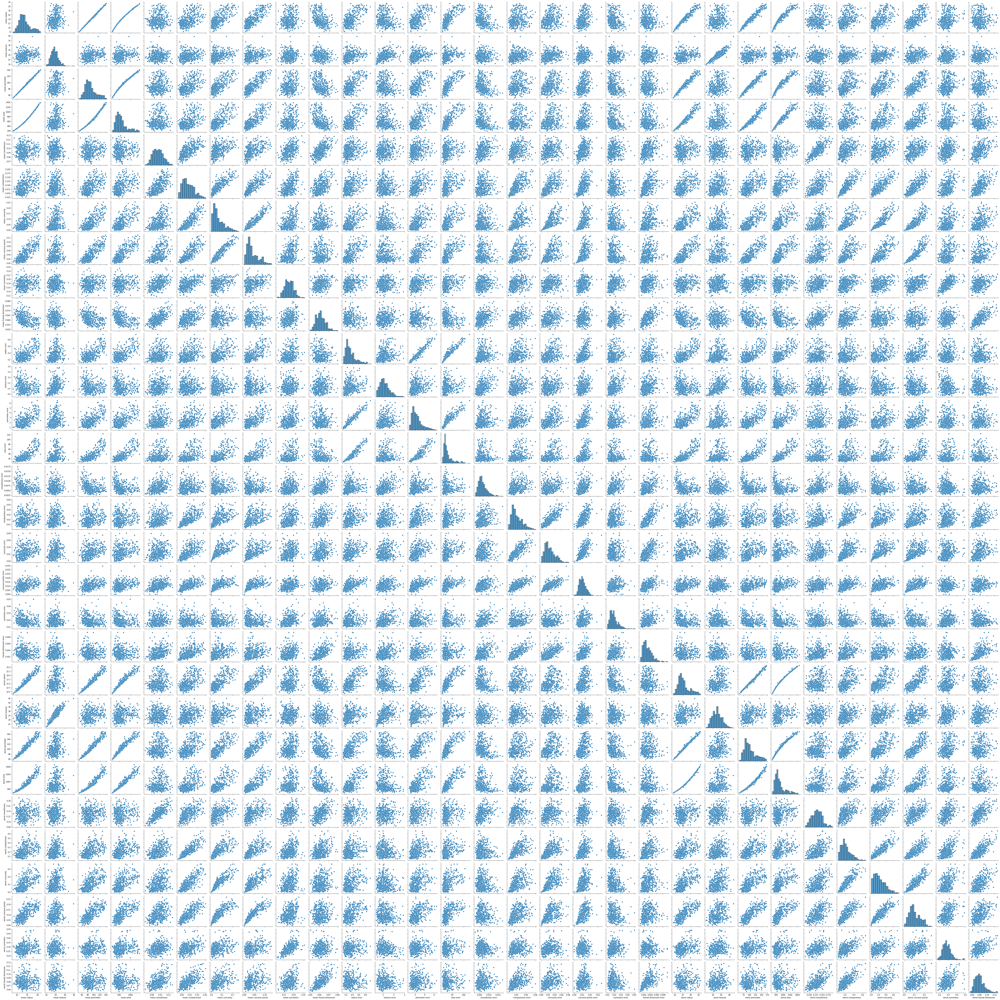

In [29]:
#Chequemos el scatterplot
sns.pairplot(data[vcont])

# Reducción de dimensiones

In [30]:
import plotly
import plotly.graph_objects as go
import plotly.express as px
from plotly.offline import plot,iplot
import cufflinks as cf
pd.options.plotting.backend = "plotly"
cf.go_offline()
#Veamos las correlaciones entre variables conyinuas
data[[x for x in vcont]].corr(method="spearman").iplot(kind="heatmap",colorscale="orrd",title="Matriz de Correlación")

In [31]:
#Guardamos la matriz de correlación de spearman
correlaciones = data[[x for x in vcont]].corr(method="spearman")
correlaciones

,mean radius,mean texture,mean perimeter,mean area,mean smoothness,mean compactness,mean concavity,mean concave points,mean symmetry,mean fractal dimension,radius error,texture error,perimeter error,area error,smoothness error,compactness error,concavity error,concave points error,symmetry error,fractal dimension error,worst radius,worst texture,worst perimeter,worst area,worst smoothness,worst compactness,worst concavity,worst concave points,worst symmetry,worst fractal dimension
mean radius,1.000000,0.262698,0.998086,0.999502,0.062811,0.480783,0.639311,0.729758,0.119516,-0.412326,0.487309,-0.175860,0.504049,0.693143,-0.342480,0.227859,0.342616,0.375850,-0.275440,-0.045591,0.976908,0.247065,0.970003,0.976657,0.071946,0.482445,0.596386,0.701526,0.173949,0.035294
mean texture,0.262698,1.000000,0.269299,0.266280,0.006481,0.231277,0.310597,0.248656,0.113663,-0.070756,0.341844,0.469387,0.360092,0.359364,0.075941,0.254270,0.294985,0.226701,0.029151,0.123646,0.301588,0.906138,0.310754,0.304012,0.097855,0.253955,0.309330,0.267909,0.132394,0.100368
mean perimeter,0.998086,0.269299,1.000000,0.997073,0.098207,0.525969,0.673130,0.757646,0.144037,-0.372978,0.496154,-0.172126,0.519209,0.699717,-0.328593,0.267990,0.376075,0.403550,-0.268703,-0.011158,0.979376,0.254638,0.976965,0.978473,0.104609,0.523585,0.629078,0.729724,0.194426,0.074806
mean area,0.999502,0.266280,0.997073,1.000000,0.048863,0.468242,0.634500,0.723038,0.111927,-0.424982,0.490439,-0.173690,0.506641,0.696888,-0.344271,0.221593,0.339562,0.369590,-0.276976,-0.052167,0.977628,0.251087,0.970118,0.978209,0.063482,0.474732,0.593319,0.696301,0.170440,0.026616
mean smoothness,0.062811,0.006481,0.098207,0.048863,1.000000,0.679649,0.470070,0.529532,0.478618,0.626169,0.269586,0.096925,0.264762,0.218911,0.346258,0.343101,0.312331,0.423936,0.123289,0.372155,0.110429,0.040953,0.137655,0.096685,0.787770,0.435248,0.360447,0.438837,0.324019,0.498654
mean compactness,0.480783,0.231277,0.525969,0.468242,0.679649,1.000000,0.858880,0.825906,0.491473,0.448352,0.441141,0.008222,0.509062,0.485842,0.093940,0.762462,0.709316,0.670497,0.011496,0.537147,0.521332,0.227682,0.573139,0.507705,0.591071,0.879774,0.790750,0.792800,0.406748,0.648344
mean concavity,0.639311,0.310597,0.673130,0.634500,0.470070,0.858880,1.000000,0.915129,0.388759,0.167646,0.529064,0.021102,0.589528,0.612043,0.048399,0.700547,0.839846,0.729892,-0.053455,0.432451,0.675958,0.317979,0.716254,0.669476,0.488431,0.817352,0.929884,0.885748,0.349360,0.488720
mean concave points,0.729758,0.248656,0.757646,0.723038,0.529532,0.825906,0.915129,1.000000,0.379687,0.095572,0.568508,-0.017067,0.608548,0.670140,0.016934,0.542321,0.630303,0.738266,-0.093922,0.317869,0.756923,0.260017,0.785638,0.748627,0.496147,0.724708,0.801872,0.923430,0.321410,0.393613
mean symmetry,0.119516,0.113663,0.144037,0.111927,0.478618,0.491473,0.388759,0.379687,1.000000,0.313036,0.298947,0.101237,0.315315,0.254552,0.162097,0.372396,0.311714,0.338896,0.345421,0.299186,0.155852,0.112452,0.178263,0.144779,0.360469,0.365128,0.320008,0.339952,0.680022,0.294022
mean fractal dimension,-0.412326,-0.070756,-0.372978,-0.424982,0.626169,0.448352,0.167646,0.095572,0.313036,1.000000,-0.060225,0.129151,-0.018407,-0.190135,0.382832,0.397694,0.250924,0.221542,0.245871,0.612280,-0.363542,-0.057834,-0.319710,-0.377067,0.505927,0.320840,0.135936,0.070320,0.204250,0.700327


In [32]:
# Revisamos que no haya variables muy correlacionadas
for col in correlaciones.columns:
    aux = correlaciones[[col]][correlaciones[[col]]>0.8].dropna()
    if len(aux)>1:
        display(aux)

,mean radius
mean radius,1.000000
mean perimeter,0.998086
mean area,0.999502
worst radius,0.976908
worst perimeter,0.970003
worst area,0.976657


,mean texture
mean texture,1.000000
worst texture,0.906138


,mean perimeter
mean radius,0.998086
mean perimeter,1.000000
mean area,0.997073
worst radius,0.979376
worst perimeter,0.976965
worst area,0.978473


,mean area
mean radius,0.999502
mean perimeter,0.997073
mean area,1.000000
worst radius,0.977628
worst perimeter,0.970118
worst area,0.978209


,mean compactness
mean compactness,1.000000
mean concavity,0.858880
mean concave points,0.825906
worst compactness,0.879774


,mean concavity
mean compactness,0.858880
mean concavity,1.000000
mean concave points,0.915129
concavity error,0.839846
worst compactness,0.817352
worst concavity,0.929884
worst concave points,0.885748


,mean concave points
mean compactness,0.825906
mean concavity,0.915129
mean concave points,1.000000
worst concavity,0.801872
worst concave points,0.923430


,radius error
radius error,1.000000
perimeter error,0.957310
area error,0.949601


,perimeter error
radius error,0.957310
perimeter error,1.000000
area error,0.924739


,area error
radius error,0.949601
perimeter error,0.924739
area error,1.000000


,compactness error
compactness error,1.000000
concavity error,0.840154


,concavity error
mean concavity,0.839846
compactness error,0.840154
concavity error,1.000000


,worst radius
mean radius,0.976908
mean perimeter,0.979376
mean area,0.977628
worst radius,1.000000
worst perimeter,0.992864
worst area,0.998762


,worst texture
mean texture,0.906138
worst texture,1.000000


,worst perimeter
mean radius,0.970003
mean perimeter,0.976965
mean area,0.970118
worst radius,0.992864
worst perimeter,1.000000
worst area,0.991861


,worst area
mean radius,0.976657
mean perimeter,0.978473
mean area,0.978209
worst radius,0.998762
worst perimeter,0.991861
worst area,1.000000


,worst compactness
mean compactness,0.879774
mean concavity,0.817352
worst compactness,1.000000
worst concavity,0.889964
worst concave points,0.820245


,worst concavity
mean concavity,0.929884
mean concave points,0.801872
worst compactness,0.889964
worst concavity,1.000000
worst concave points,0.887000


,worst concave points
mean concavity,0.885748
mean concave points,0.923430
worst compactness,0.820245
worst concavity,0.887000
worst concave points,1.000000


In [33]:
# Borramos las columnas que tienen alta correlación entre ellas
data_model=data.copy()
data_model.drop(columns = ['mean perimeter', 'mean area',
                       'worst radius', 'worst perimeter', 'worst area',
                       'worst texture', 'mean radius', 'mean concavity',
                       'mean concave points', 'worst compactness', 'worst concavity',
                       'mean compactness', 'concavity error', 'worst concave points',
                       'perimeter error', 'area error', 'radius error', 'compactness error',
                       'mean texture'], inplace = True)
data_model

,mean smoothness,mean symmetry,mean fractal dimension,texture error,smoothness error,concave points error,symmetry error,fractal dimension error,worst smoothness,worst symmetry,worst fractal dimension,Cancer
0,0.08474,0.1812,0.05667,0.7339,0.005225,0.013400,0.01389,0.003532,0.1238,0.2750,0.08902,0
1,0.10960,0.2069,0.05999,0.7869,0.006150,0.020580,0.02250,0.004571,0.1444,0.3613,0.08758,0
2,0.10030,0.1809,0.05883,0.7813,0.011490,0.018850,0.01756,0.005115,0.1374,0.2364,0.07678,0
3,0.12780,0.2087,0.07613,0.8902,0.007510,0.011370,0.02165,0.005082,0.1791,0.3985,0.12440,0
4,0.09463,0.1794,0.05742,0.7732,0.004314,0.010390,0.01369,0.002179,0.1442,0.3063,0.08368,0
...,...,...,...,...,...,...,...,...,...,...,...,...
450,0.10030,0.1791,0.06331,2.0900,0.012910,0.007082,0.02572,0.002278,0.1265,0.2262,0.06742,1
451,0.08473,0.1454,0.06147,1.1080,0.004242,0.016060,0.01638,0.004406,0.1026,0.2258,0.08004,1
452,0.09261,0.1388,0.06570,2.9040,0.008200,0.012670,0.01488,0.004738,0.1298,0.2112,0.08732,1
453,0.09929,0.1537,0.06171,1.4920,0.007256,0.016260,0.02080,0.005304,0.1241,0.2250,0.08321,1


In [34]:
# Vemos correlación con el objetivo

# Obtenemos las variables con las que vamos a calcular la correlación con el objetivo
variables=list(data_model.columns)
variables

['mean smoothness',
 'mean symmetry',
 'mean fractal dimension',
 'texture error',
 'smoothness error',
 'concave points error',
 'symmetry error',
 'fractal dimension error',
 'worst smoothness',
 'worst symmetry',
 'worst fractal dimension',
 'Cancer']

In [35]:
# Gráficamos el mapa de calonm
data[variables].corr(method="spearman").iplot(kind="heatmap",colorscale="orrd",title="Matriz de Correlación")

In [36]:
#De las correlaciones obtenidas con el target sacamos su valor absoluto
correlacion_target=data[variables].corr(method="spearman")
correlacion_target=abs(correlacion_target)

In [37]:
correlacion_target

,mean smoothness,mean symmetry,mean fractal dimension,texture error,smoothness error,concave points error,symmetry error,fractal dimension error,worst smoothness,worst symmetry,worst fractal dimension,Cancer
mean smoothness,1.000000,0.478618,0.626169,0.096925,0.346258,0.423936,0.123289,0.372155,0.787770,0.324019,0.498654,0.279322
mean symmetry,0.478618,1.000000,0.313036,0.101237,0.162097,0.338896,0.345421,0.299186,0.360469,0.680022,0.294022,0.293192
mean fractal dimension,0.626169,0.313036,1.000000,0.129151,0.382832,0.221542,0.245871,0.612280,0.505927,0.204250,0.700327,0.096717
texture error,0.096925,0.101237,0.129151,1.000000,0.456606,0.278279,0.360040,0.301760,0.001012,0.160552,0.087840,0.007007
smoothness error,0.346258,0.162097,0.382832,0.456606,1.000000,0.350304,0.472378,0.435549,0.416082,0.101789,0.098248,0.055657
concave points error,0.423936,0.338896,0.221542,0.278279,0.350304,1.000000,0.230291,0.562664,0.310800,0.069007,0.280497,0.438430
symmetry error,0.123289,0.345421,0.245871,0.360040,0.472378,0.230291,1.000000,0.328340,0.049834,0.243430,0.083156,0.141963
fractal dimension error,0.372155,0.299186,0.612280,0.301760,0.435549,0.562664,0.328340,1.000000,0.294599,0.085911,0.668144,0.145221
worst smoothness,0.787770,0.360469,0.505927,0.001012,0.416082,0.310800,0.049834,0.294599,1.000000,0.453593,0.620506,0.386597
worst symmetry,0.324019,0.680022,0.204250,0.160552,0.101789,0.069007,0.243430,0.085911,0.453593,1.000000,0.435063,0.372436


In [38]:
correlacion_target[["Cancer"]].sort_values(by ='Cancer',ascending = False).style.background_gradient()

,Cancer
Cancer,1.000000
concave points error,0.438430
worst smoothness,0.386597
worst symmetry,0.372436
mean symmetry,0.293192
worst fractal dimension,0.281342
mean smoothness,0.279322
fractal dimension error,0.145221
symmetry error,0.141963
mean fractal dimension,0.096717


In [39]:
#Guardamos esa tabla
correlacion_target = correlacion_target[["Cancer"]].sort_values(by ='Cancer',ascending = False)
#Identificamos el index de las variables con correlación abajo de 0.1
cols_baja_corr = list(correlacion_target.loc[correlacion_target["Cancer"]<0.1].index)
cols_baja_corr

['mean fractal dimension', 'smoothness error', 'texture error']

In [40]:
#Eliminamos dichas columnas del dataset
data = data.drop(cols_baja_corr,axis=1)
data.head(5)

,mean radius,mean texture,mean perimeter,mean area,mean smoothness,mean compactness,mean concavity,mean concave points,mean symmetry,radius error,perimeter error,area error,compactness error,concavity error,concave points error,symmetry error,fractal dimension error,worst radius,worst texture,worst perimeter,worst area,worst smoothness,worst compactness,worst concavity,worst concave points,worst symmetry,worst fractal dimension,Cancer
0,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,0.1812,0.5435,3.398,74.08,0.01308,0.01860,0.01340,0.01389,0.003532,24.99,23.41,158.8,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902,0
1,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,0.2069,0.7456,4.585,94.03,0.04006,0.03832,0.02058,0.02250,0.004571,23.57,25.53,152.5,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758,0
2,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,0.1809,0.7572,5.438,94.44,0.02461,0.05688,0.01885,0.01756,0.005115,22.54,16.67,152.2,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678,0
3,12.45,15.70,82.57,477.1,0.12780,0.17000,0.1578,0.08089,0.2087,0.3345,2.217,27.19,0.03345,0.03672,0.01137,0.02165,0.005082,15.47,23.75,103.4,741.6,0.1791,0.5249,0.5355,0.1741,0.3985,0.12440,0
4,18.25,19.98,119.60,1040.0,0.09463,0.10900,0.1127,0.07400,0.1794,0.4467,3.180,53.91,0.01382,0.02254,0.01039,0.01369,0.002179,22.88,27.66,153.2,1606.0,0.1442,0.2576,0.3784,0.1932,0.3063,0.08368,0


In [41]:
data.shape

(455, 28)

In [42]:
#De nuestras variables continuas detctadas quitemos las eliminadas
variables = [c for c in variables if c not in cols_baja_corr+["Cancer"]]
variables

['mean smoothness',
 'mean symmetry',
 'concave points error',
 'symmetry error',
 'fractal dimension error',
 'worst smoothness',
 'worst symmetry',
 'worst fractal dimension']

In [43]:
objetivo=["Cancer"]

In [44]:
data[variables].head(5)

,mean smoothness,mean symmetry,concave points error,symmetry error,fractal dimension error,worst smoothness,worst symmetry,worst fractal dimension
0,0.08474,0.1812,0.01340,0.01389,0.003532,0.1238,0.2750,0.08902
1,0.10960,0.2069,0.02058,0.02250,0.004571,0.1444,0.3613,0.08758
2,0.10030,0.1809,0.01885,0.01756,0.005115,0.1374,0.2364,0.07678
3,0.12780,0.2087,0.01137,0.02165,0.005082,0.1791,0.3985,0.12440
4,0.09463,0.1794,0.01039,0.01369,0.002179,0.1442,0.3063,0.08368


# Tratamiento de los datos para el modelo

In [76]:
X=data[variables] #Variables predictoras
y=data[objetivo] #Variable objetivo

In [77]:
data.shape

(455, 28)

In [104]:
#Dividimos nuestros datos en conjunto de prueba y conjunto de entrenamiento
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y,test_size = 0.15, random_state = 0)

In [105]:
X_train.shape[0]

386

In [106]:
X_test.shape[0]

69

In [107]:
data["Cancer"].value_counts(1,dropna=False)

1    0.696703
0    0.303297
Name: Cancer, dtype: float64

# Modelo
## kNN

/Users/jesusarredondo/Documents/Diplomado/Modulo2/mod2/lib/python3.9/site-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().

/Users/jesusarredondo/Documents/Diplomado/Modulo2/mod2/lib/python3.9/site-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().

/Users/jesusarredondo/Documents/Diplomado/Modulo2/mod2/lib/python3.9/site-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().

/Users/jesusarredondo/Documents/Diplomado/Modulo2/mod2/lib/python3.9/site-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning:

A col

([<matplotlib.axis.XTick at 0x7fc148c89ac0>,
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

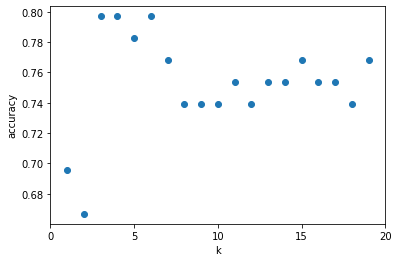

In [108]:
# Definamos la mejor k para nuestro modelo

from sklearn.neighbors import KNeighborsClassifier

k_range = range(1, 20)
scores = []
for k in k_range:
    knn = KNeighborsClassifier(n_neighbors = k)
    knn.fit(X_train, y_train)
    scores.append(knn.score(X_test, y_test))
plt.figure()
plt.xlabel('k')
plt.ylabel('accuracy')
plt.scatter(k_range, scores)
plt.xticks([0,5,10,15,20])

/Users/jesusarredondo/Documents/Diplomado/Modulo2/mod2/lib/python3.9/site-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().

/Users/jesusarredondo/Documents/Diplomado/Modulo2/mod2/lib/python3.9/site-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().

/Users/jesusarredondo/Documents/Diplomado/Modulo2/mod2/lib/python3.9/site-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().

/Users/jesusarredondo/Documents/Diplomado/Modulo2/mod2/lib/python3.9/site-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning:

A col

/Users/jesusarredondo/Documents/Diplomado/Modulo2/mod2/lib/python3.9/site-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().

/Users/jesusarredondo/Documents/Diplomado/Modulo2/mod2/lib/python3.9/site-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().

/Users/jesusarredondo/Documents/Diplomado/Modulo2/mod2/lib/python3.9/site-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().

/Users/jesusarredondo/Documents/Diplomado/Modulo2/mod2/lib/python3.9/site-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning:

A col

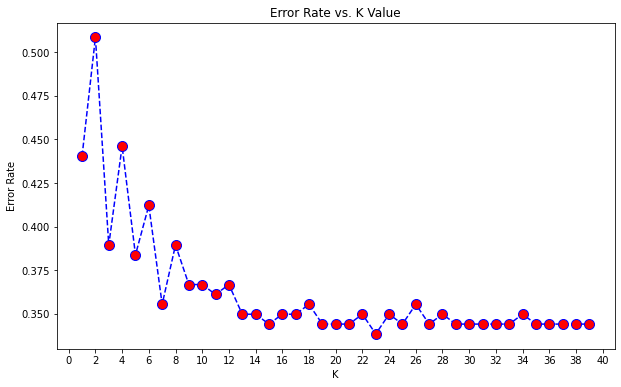

In [109]:
import numpy as np
error_rate = []

for i in range(1,40):
    
    knn = KNeighborsClassifier(n_neighbors=i)
    knn.fit(X_train,y_train)
    pred_i = knn.predict(X_test)
    error_rate.append(np.mean(pred_i != np.array(y_test).reshape(-1,1)))
    
plt.figure(figsize=(10,6))
plt.plot(range(1,40),error_rate,color='blue', linestyle='dashed', marker='o',
         markerfacecolor='red', markersize=10)
plt.title('Error Rate vs. K Value')
plt.xlabel('K')
plt.ylabel('Error Rate')
plt.xticks(np.arange(0, 42, 2));

In [110]:
np.array(y_test).reshape(1,-1)

array([[1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0,
        1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1,
        1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1,
        1, 1, 0]])

In [111]:
# Obtamos por k= 5
classifier = KNeighborsClassifier(n_neighbors = 3)
classifier.fit(X_train, y_train)

/Users/jesusarredondo/Documents/Diplomado/Modulo2/mod2/lib/python3.9/site-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().



KNeighborsClassifier(n_neighbors=3)

In [112]:
from sklearn.model_selection import cross_val_score
#Hacemos el cross validation del modelo
ls_res = cross_val_score(estimator = classifier, X=X_train, y=y_train, cv=4, n_jobs=-1, scoring="roc_auc")
#Sacamos la media y la desv estandar
np.mean(ls_res),np.std(ls_res)

/Users/jesusarredondo/Documents/Diplomado/Modulo2/mod2/lib/python3.9/site-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/Users/jesusarredondo/Documents/Diplomado/Modulo2/mod2/lib/python3.9/site-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/Users/jesusarredondo/Documents/Diplomado/Modulo2/mod2/lib/python3.9/site-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/Users/jesusarredondo/Documents/Diplomado/Modulo2/mod2/lib/python3.9/site-packages/sk

(0.7551046743967788, 0.03248512085644595)

In [113]:
from sklearn.metrics import classification_report,confusion_matrix
pred = classifier.predict(X_test)

print(' K=3')
print('Train')
print(classification_report(y_train,classifier.predict(X_train)))


print('\n')
print('Test')
print(confusion_matrix(y_test,pred))
print('\n')
print(classification_report(y_test,pred))

 K=3
Train
              precision    recall  f1-score   support

           0       0.81      0.71      0.76       117
           1       0.88      0.93      0.90       269

    accuracy                           0.86       386
   macro avg       0.85      0.82      0.83       386
weighted avg       0.86      0.86      0.86       386



Test
[[11 10]
 [ 4 44]]


              precision    recall  f1-score   support

           0       0.73      0.52      0.61        21
           1       0.81      0.92      0.86        48

    accuracy                           0.80        69
   macro avg       0.77      0.72      0.74        69
weighted avg       0.79      0.80      0.79        69



In [114]:
from sklearn.metrics import roc_auc_score,accuracy_score
def metricas(model,Xv,yv): #Mide efectividad de un Modelo Predictivo
    print( " Roc Validate: %.3f" %roc_auc_score(y_score=model.predict_proba(Xv)[:,1],y_true=yv))
    print( " Acc Validate: %.3f" %accuracy_score(y_pred=model.predict(Xv),y_true=yv))
    print( " Matrix Conf Validate: ", "\n",confusion_matrix(y_pred=model.predict(Xv),y_true=yv))
    
metricas(classifier,X_test, y_test)


 Roc Validate: 0.794
 Acc Validate: 0.797
 Matrix Conf Validate:  
 [[11 10]
 [ 4 44]]


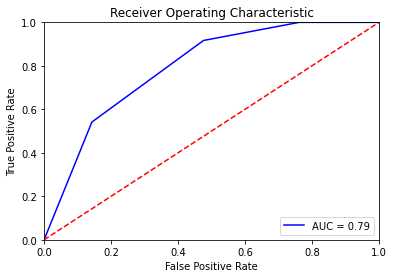

In [115]:
from sklearn.metrics import roc_curve
import matplotlib.pyplot as plt
fpr, tpr, thresh = roc_curve(y_test,classifier.predict_proba(X_test)[:,1])
plt.title('Receiver Operating Characteristic')
auc = roc_auc_score(y_test,classifier.predict_proba(X_test)[:,1])
plt.plot(fpr, tpr, 'b', label = f'AUC = {auc.round(2)}')
plt.legend(loc = 'lower right')
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.show()

# Comparacion de métricas

In [116]:
# Calculamos todas las métricas del modelo KNN y su matriz de confusión
accuracy_modelo = (11+44)/69
precision_modelo = 11/(11+10)
recall_modelo = 11/(11+4)
f1_score_modelo = 2 * (precision_modelo*recall_modelo)/(precision_modelo+recall_modelo)
especificidad_modelo = 44/(44+10)

In [117]:
# Calculamos las métricas para el doctor
accuracy_doctor = (56+92)/(56+10+13+92)
precision_doctor = 56/(56+10)
recall_doctor = 56/(56+13)
f1_score_doctor = 2 * (precision_doctor*recall_doctor)/(precision_doctor+recall_doctor)
especificidad_doctor = 92/(92+10)

In [118]:
# Comparamos las métricas
print(accuracy_modelo>accuracy_doctor)
print(precision_modelo > precision_doctor)
print(recall_modelo>recall_doctor)
print(f1_score_modelo>f1_score_doctor)
print(especificidad_modelo>especificidad_doctor)

False
False
False
False
False


## Balanceando clases

/Users/jesusarredondo/Documents/Diplomado/Modulo2/mod2/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



Text(0.5, 1.0, 'Target variable count')

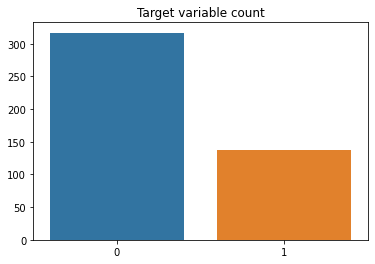

In [119]:
x=data['Cancer'].value_counts().values
sns.barplot([0,1],x)
plt.title('Target variable count')

In [120]:
from imblearn.over_sampling import SMOTE
smote = SMOTE(sampling_strategy='minority', random_state=0)
X_sm, y_sm = smote.fit_resample(X_train, y_train)

/Users/jesusarredondo/Documents/Diplomado/Modulo2/mod2/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



Text(0.5, 1.0, 'Target variable count')

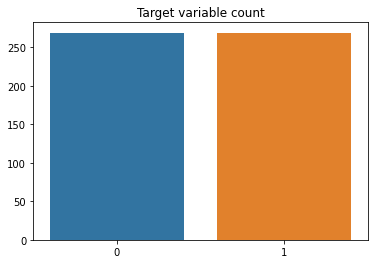

In [121]:
x=y_sm.value_counts().values
sns.barplot([0,1],x)
plt.title('Target variable count')

In [124]:
classifier_balance = KNeighborsClassifier(n_neighbors = 3)
classifier_balance.fit(X_sm, y_sm)

/Users/jesusarredondo/Documents/Diplomado/Modulo2/mod2/lib/python3.9/site-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().



KNeighborsClassifier(n_neighbors=3)

In [125]:
#Hacemos el cross validation del modelo
ls_res_balance = cross_val_score(estimator = classifier_balance, X=X_sm, y=y_sm, cv=4, n_jobs=-1, scoring="roc_auc")
#Sacamos la media y la desv estandar
np.mean(ls_res_balance),np.std(ls_res_balance)

/Users/jesusarredondo/Documents/Diplomado/Modulo2/mod2/lib/python3.9/site-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/Users/jesusarredondo/Documents/Diplomado/Modulo2/mod2/lib/python3.9/site-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/Users/jesusarredondo/Documents/Diplomado/Modulo2/mod2/lib/python3.9/site-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/Users/jesusarredondo/Documents/Diplomado/Modulo2/mod2/lib/python3.9/site-packages/sk

(0.8885494607733938, 0.03844538630234816)

In [126]:
pred = classifier_balance.predict(X_test)

print(' K=3')
print('Train')
print(classification_report(y_sm,classifier_balance.predict(X_sm)))


print('\n')
print('Test')
print(confusion_matrix(y_test,pred))
print('\n')
print(classification_report(y_test,pred))

 K=3
Train
              precision    recall  f1-score   support

           0       0.85      0.97      0.90       269
           1       0.96      0.83      0.89       269

    accuracy                           0.90       538
   macro avg       0.90      0.90      0.90       538
weighted avg       0.90      0.90      0.90       538



Test
[[16  5]
 [12 36]]


              precision    recall  f1-score   support

           0       0.57      0.76      0.65        21
           1       0.88      0.75      0.81        48

    accuracy                           0.75        69
   macro avg       0.72      0.76      0.73        69
weighted avg       0.78      0.75      0.76        69



In [127]:
metricas(classifier_balance,X_sm, y_sm)

 Roc Validate: 0.976
 Acc Validate: 0.896
 Matrix Conf Validate:  
 [[260   9]
 [ 47 222]]


In [128]:
metricas(classifier_balance,X_test, y_test)

 Roc Validate: 0.804
 Acc Validate: 0.754
 Matrix Conf Validate:  
 [[16  5]
 [12 36]]


In [129]:
# Calculamos todas las métricas del modelo KNN y su matriz de confusión
accuracy_modelo_balanceado = (16+36)/69
precision_modelo_balanceado = 16/(16+5)
recall_modelo_balanceado = 16/(16+12)
f1_score_modelo_balanceado = 2 * (precision_modelo*recall_modelo_balanceado)/(precision_modelo_balanceado+recall_modelo_balanceado)
especificidad_modelo_balanceado = 36/(36+5)

In [130]:
print(accuracy_modelo_balanceado>accuracy_doctor)
print(precision_modelo_balanceado > precision_doctor)
print(recall_modelo_balanceado>recall_doctor)
print(f1_score_modelo_balanceado>f1_score_doctor)
print(especificidad_modelo_balanceado>especificidad_doctor)

False
False
False
False
False


In [132]:
print("Modelo")
print("Falsos positivos sobre total positivos: " + str(5/(16+5)))
print("Falsos negativos sobre total negativos: " +  str(12/(12+36)))
print("\n")
print("Doctor")
print("Falsos positivos sobre total positivos: " + str(10/(56+10)))
print("Falsos negativos sobre total negativos: " +  str(13/(13+92)))

Modelo
Falsos positivos sobre total positivos: 0.23809523809523808
Falsos negativos sobre total negativos: 0.25


Doctor
Falsos positivos sobre total positivos: 0.15151515151515152
Falsos negativos sobre total negativos: 0.12380952380952381


Oservaciòn: Podemos observar que si bien el modelo se comporta bien al momento de ser entrenado pero por la poca cantidad de datos aun balanceado las clases no se comporta tan bien en la prediccion por lo que consideramos mejor el pronostico de doctor

In [135]:
pd.to_pickle(classifier_balance,"Modelo_Knn_balanceado.pkl")
pd.to_pickle(classifier,"Modelo_Knn.pkl")